# Fashion-MINST

## Prepare data

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import fetch_openml
from sklearn.decomposition import PCA
import time
from sklearn.manifold import TSNE
import umap
from sklearn.preprocessing import StandardScaler

In [2]:
# Load Fashion-MNIST data
fmnist = fetch_openml("Fashion-MNIST", version=1, cache=True)

In [3]:
# Randomly select 10,000 images
np.random.seed(123)

indices = np.random.choice(70000, 10000)
X = fmnist.data[indices] / 255.0
y = fmnist.target[indices]

In [4]:
# Normalize data 
scaler = StandardScaler()
X = scaler.fit_transform(X)

## PCA
For the sake of data visualization, let's reduce the original feature space to a two-dimensional space.

In [5]:
# Dimension reduction via PCA
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)

In [6]:
# Visualize results
plt.figure(figsize=(10,5))
colours = ["r","b","g","c","m","y","k","r","burlywood","chartreuse"]
for i in range(X_pca.shape[0]):
    plt.text(X_pca[i, 0], X_pca[i, 1], str(y[i]),
             color=colours[int(y[i])],
             fontdict={'weight': 'bold', 'size': 100}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

Some classes are hard to distinguish on this two-dimensional space, such as the red, yellow, and green dots on the left corner. Overall, PCA with two components doesn't do a very satisfactory job on the Fashion MNIST data.

## t-SNE

In [7]:
# Dimension reduction via t-SNE
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
X_tsne = tsne.fit_transform(X)

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 10000 samples in 0.712s...
[t-SNE] Computed neighbors for 10000 samples in 152.434s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10000
[t-SNE] Computed conditional probabilities for sample 2000 / 10000
[t-SNE] Computed conditional probabilities for sample 3000 / 10000
[t-SNE] Computed conditional probabilities for sample 4000 / 10000
[t-SNE] Computed conditional probabilities for sample 5000 / 10000
[t-SNE] Computed conditional probabilities for sample 6000 / 10000
[t-SNE] Computed conditional probabilities for sample 7000 / 10000
[t-SNE] Computed conditional probabilities for sample 8000 / 10000
[t-SNE] Computed conditional probabilities for sample 9000 / 10000
[t-SNE] Computed conditional probabilities for sample 10000 / 10000
[t-SNE] Mean sigma: 5.352463
[t-SNE] KL divergence after 250 iterations with early exaggeration: 78.583878
[t-SNE] KL divergence after 300 iterations: 2.587918


In [8]:
# Visualize results
plt.figure(figsize=(10,5))
colours = ["r","b","g","c","m","y","k","r","burlywood","chartreuse"]
for i in range(X_tsne.shape[0]):
    plt.text(X_tsne[i, 0], X_tsne[i, 1], str(y[i]),
             color=colours[int(y[i])],
             fontdict={'weight': 'bold', 'size': 50}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

Compared to PCA, t-SNE does a much better job distinguishing between different classes. However, the overlap between some classes is still obvious. Let's try different perplexity to see if we can get cleaner results.

In [9]:
# List of perplexities to try
perplexities = [5, 30, 50, 100]

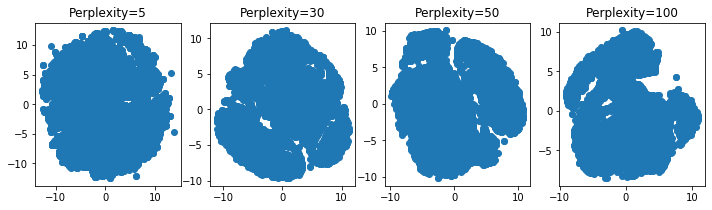

In [10]:
# Visualize results for each perplexity
(fig, subplots) =  plt.subplots(1, 4, figsize=(12, 3))

for i, perplexity in enumerate(perplexities):
    # Subplot position 
    ax = subplots[i]
    
    # Fit t-SNE model
    tsne = TSNE(n_components=2, verbose=0, perplexity=perplexity, n_iter=300)
    tsne_results = tsne.fit_transform(X)
    
    # Visualize results
    ax.scatter(tsne_results[:, 0], tsne_results[:, 1])
    ax.set_title("Perplexity=%d" % perplexity)
    
plt.show()

When perplexity = 5, classes are indistinguishable from one another. The higher the perplexity, the more distinct different classes seem to be.

## UMAP

In [11]:
# Dimension reduction via UMAP
umap = umap.UMAP(n_neighbors=5, min_dist=0.3, metric='correlation')
X_umap = umap.fit_transform(X)

In [12]:
# Visualize results
plt.figure(figsize=(10,5))
colours = ["r","b","g","c","m","y","k","r","burlywood","chartreuse"]
for i in range(X_umap.shape[0]):
    plt.text(X_umap[i, 0], X_umap[i, 1], y[i],
             color=colours[int(y[i])],
             fontdict={'weight': 'bold', 'size': 50}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

Compared to PCA and t-SNE, UMAP le in yet more distinct classes on a two-dimensional space. 